<a href="https://colab.research.google.com/github/choaibe-A/jbbmo-Introduction-to-Git-and-GitHub/blob/master/M1DS_TP_Spectral_analysis_and_filtering_BAINE_Bouchaib.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lab session: Spectral analysis and filtering

In [1]:
import numpy as np
import scipy.io as sio
import scipy
import matplotlib.pyplot as plt
import plotly.express as px
import pandas as pd
plt.rcParams["figure.figsize"]=(15,10) # Just to have proper figure size

## Part 1: Spectral analysis

>Load data from RTE_2016-2018.mat via `sio.loadmat`. It contains the electric power consumption in France between the 1st january 2016 and the 31st december 2018. It has been sampled every 30 minutes.
> - How many samples are present? Is it what is expected given the sampling frequency?
> - Plot the whole signal and plot a full week. Use a proper unit on the x axis.

In [2]:
data_path = '/content/RTE_2016-2018.mat'
data = sio.loadmat(data_path)
data.keys()

dict_keys(['__header__', '__version__', '__globals__', 'Consommation'])

In [3]:
# Extract the consumption data
consumption = data['Consommation'].squeeze()

# Number of samples
num_samples = consumption.size

# Expected number of samples calculation: 3 years * 365 days/year * 48 samples/day (every 30 minutes)
# Adding one extra day for the leap year 2016
expected_samples = (3 * 365 + 1) * 48


(num_samples, expected_samples)


(52608, 52608)

In [4]:
# Generate a date range
dates = pd.date_range(start='2016-01-01', periods=num_samples, freq='30T')

# Convert the consumption data to a DataFrame for easier plotting
df = pd.DataFrame({'Date': dates, 'Consumption': consumption.flatten()})

# Plot the entire signal
fig_total = px.line(df, x='Date', y='Consumption', title='Electric Power Consumption in France (2016-2018)', labels={'Consumption': 'Consumption (MW)'})

# Plot a full week (let's take the first week of 2016 for simplicity)
df_week = df[(df['Date'] >= '2016-01-01') & (df['Date'] < '2016-01-08')]
fig_week = px.line(df_week, x='Date', y='Consumption', title='Electric Power Consumption in France (First Week of 2016)', labels={'Consumption': 'Consumption (MW)'})

In [30]:
fig_total.show()

In [6]:
fig_week.show()

>Use `np.fft.fft` to compute the Fourier transform of the signal.
>Use `np.fft.fftshift` on the Fourier transform to center the spectrum around 0.
>What are the frequencies associated with the spectrum? Plot the amplitude and the phase.


In [32]:
# Step 1: Compute the FFT of the signal
fft_signal = np.fft.fft(consumption.flatten())

# Step 2: Center the spectrum
fft_shifted = np.fft.fftshift(fft_signal)

# Frequency range: considering the sampling rate is every 30 minutes
freq = np.fft.fftshift(np.fft.fftfreq(num_samples, d=30*60))  # d is the sample spacing in seconds

# Magnitude and Phase
magnitude = np.abs(fft_signal)/num_samples
phase = np.angle(fft_signal)

# Magnitude and Phase Centred
magnitude_c = np.abs(fft_shifted)/num_samples
phase_c = np.angle(fft_shifted)

(freq, magnitude, phase)


(array([-0.00027778, -0.00027777, -0.00027776, ...,  0.00027775,
         0.00027776,  0.00027777]),
 array([54550.10956509,   154.33950379,   460.25426218, ...,
         6726.72697304,   460.25426218,   154.33950379]),
 array([ 0.        , -2.97344447, -2.71199979, ...,  0.30819041,
         2.71199979,  2.97344447]))

In [33]:
# Plotting the amplitude spectrum
fig_amplitude = px.line(x=freq, y=magnitude, labels={'x': 'Frequency (Hz)', 'y': 'Amplitude'}, title='Amplitude Spectrum')
fig_amplitude.show()

In [34]:
# Plotting the amplitude spectrum centred
fig_amplitude = px.line(x=freq, y=magnitude_c, labels={'x': 'Frequency (Hz)', 'y': 'Amplitude'}, title='Amplitude Spectrum Centred')
fig_amplitude.show()

In [10]:
# Plotting the phase spectrum
fig_phase = px.line(x=freq, y=np.unwrap(phase), labels={'x': 'Frequency (Hz)', 'y': 'Phase (radians)'}, title='Phase Spectrum')
fig_phase.show()

In [11]:
# Plotting the phase spectrum centred
fig_phase = px.line(x=freq, y=np.unwrap(phase_c), labels={'x': 'Frequency (Hz)', 'y': 'Phase (radians)'}, title='Phase Spectrum Centred')
fig_phase.show()

In [12]:
px.box(magnitude)

> To which frequency correspond the higher magnitude of the spectrum? How to interpret this value for the signal? Remove this component from the time domain signal and recompute the spectrum.

The higher magnitude corresponds to the frequency 0 Hz.
We have:
$$
  \
$$

The continuous Fourier Transform of a continuous, integrable function $f(t)$ with respect to frequency $f$ in Hertz is given by:

$$
F(f) = \int_{-\infty}^{\infty} f(t) e^{-i 2 \pi f t} dt
$$

Where:
- $F(f)$ is the Fourier Transform of $f(t)$.
- $t$ represents the time domain (can be spatial or other domains in different contexts).
- $f$ is the frequency in Hertz (Hz).
- $e^{-i 2 \pi f t}$ is the kernel of the Fourier Transform, a complex exponential function.

Thus, for f=0:

$$
F(0) = \int_{-\infty}^{\infty} f(t) \ dt
$$

This integral gives the area under the curve of f(t) over the entire time domain, representing the total average value of the **signal**.


In [13]:
# Subtracting the mean (DC compenent) from the signal
signal_without_dc = consumption.flatten() - np.mean(consumption)

# Compute the FFT of the new signal without the DC component
fft_signal_without_dc = np.fft.fft(signal_without_dc)

# Apply fftshift to center the spectrum
fft_shifted_without_dc = np.fft.fftshift(fft_signal_without_dc)

# Compute the new magnitudes and phases for the adjusted signal
magnitude_without_dc = np.abs(fft_signal_without_dc)/num_samples
phase_without_dc = np.angle(fft_signal_without_dc)

# Compute the centred new magnitudes and phases for the adjusted signal
magnitude_without_dc_c = np.abs(fft_shifted_without_dc)/num_samples
phase_without_dc_c = np.angle(fft_shifted_without_dc)

# Find the frequency with the highest magnitude (excluding the DC component)
# We avoid the first element because it corresponds to the DC component
highest_frequency = freq[np.argmax(magnitude_without_dc)]
highest_magnitude = np.max(magnitude_without_dc)

(highest_frequency, highest_magnitude)

(-0.00027774609691808596, 6726.7269730373)

In [14]:
df['Consumption_DC'] = signal_without_dc
px.line(df, x='Date', y=['Consumption','Consumption_DC'], title='Electric Power Consumption in France (2016-2018)', labels={'Consumption': 'Consumption '})

In [15]:
# Plotting the amplitude spectrum without DC component
fig_amplitude_without_dc = px.line(x=freq, y=magnitude_without_dc, labels={'x': 'Frequency (Hz)', 'y': 'Amplitude'}, title='Amplitude Spectrum without DC Component')
fig_amplitude_without_dc.show()

In [16]:
# Plotting the amplitude spectrum without DC component centred
fig_amplitude_without_dc = px.line(x=freq, y=magnitude_without_dc_c, labels={'x': 'Frequency (Hz)', 'y': 'Amplitude'}, title='Amplitude Spectrum without DC Component Centred')
fig_amplitude_without_dc.show()

In [17]:
# Plotting the phase spectrum without DC component
fig_phase_without_dc = px.line(x=freq, y=np.unwrap(phase_without_dc), labels={'x': 'Frequency (Hz)', 'y': 'Phase (radians)'}, title='Phase Spectrum without DC Component')
fig_phase_without_dc.show()

> Which frequencies have a high amplitude on the spectrum? Why?

In [18]:
# High amplitudes on the spectrum
high_freq = [i for i in freq[magnitude_without_dc_c>2000]]
high_freq

[-1.1574074074074075e-05,
 -3.16808596918086e-08,
 3.16808596918086e-08,
 1.1574074074074075e-05]

In [19]:
# Periods per day
Periods = [abs(1/(i*60*60*24)) for i in high_freq]
set(Periods)

{1.0, 365.3333333333333}

The specific frequencies identified with high amplitudes were:

- Frequencies near zero, which represents a long-term trend or drift in the data.
- Frequencies corresponding to periods of approximately 1 day and 365 days.


1. **Daily Cycle (1 day)**:
   - The daily cycle reflects routine daily human activities. For instance, electricity consumption typically increases during daytime hours due to work, industrial activities, and personal use, and decreases at night.

2. **Annual Cycle (365 days)**:
   - The yearly cycle likely represents seasonal variations in electricity usage. for example increased energy consumption for heating in winter and cooling in summer, also variations due to holidays, vacation periods...




> We want to observe the yearly tendencies. Are these high or low frequencies? Create a filter in the spectral domain for removing (multiply by 0) the non desired frequencies and to keep (multiply by 1) the desired ones. What are the parameters of this filter?

We focus on the frequencies corresponding to annual cycles, which are low frequencies given the long period (365 days) associated with them.

In [20]:
# Calculate the yearly frequency in Hz
yearly_frequency = 1 / (365 * 24 * 60 * 60)

# Sampling rate
Sampling_rate = 1 / (30 * 60)  # every 30 minutes

# Frequency array - spans from 0 to the Nyquist frequency
freq = np.linspace(0, Sampling_rate / 2, num_samples // 2)

# Construct the filter mask - no need for integer conversion or np.abs here
filter_mask = freq <= yearly_frequency

# Extend the filter_mask to cover all frequencies if fft_signal_without_dc is a full spectrum
if len(filter_mask) * 2 == num_samples:
    filter_mask = np.concatenate([filter_mask, filter_mask[::-1]])

# Apply the filter in the spectral domain
filtered_fft = fft_signal_without_dc * filter_mask

> Apply this filter to the Fourier transform. Then, use the inverse Fourier transform on the filtered spectrum to obtain back a temporal signal. Due to rounding approximations, it might be necessary to cast the obtain result into a "real" (as opposed to complex) float.

In [21]:

# Perform the inverse Fourier transform
time_domain_signal = np.fft.ifft(filtered_fft)

# Due to rounding errors, the inverse FFT might introduce a small imaginary part,
# so we take only the real part of the signal
filtered_signal = np.real(time_domain_signal)


In [22]:
px.scatter(x=dates, y=filtered_signal, title='Filtered Signal - Yearly Tendencies',
                              labels={'x': 'Date', 'y': 'Consumption (MW)'})

In [35]:
fig_filtered_signal = px.line(x=dates, y=[df['Consumption_DC'],filtered_signal], title='Filtered Signal - Yearly Tendencies',
                              labels={'x': 'Date', 'y': 'Consumption'})
fig_filtered_signal.show()


## Part 2: Diffraction and telescopes

> Let us consider a light ray with amplitude $A(x,y)$ going through an opening $\Sigma$. Because light is a wave, each point of $\Sigma$ will act as a secondary source. The final light amplitude will be given by the continuous sum (i.e integral) of each amplitude, with a delay proportionnal to its distance to the center. In other words, the final amplitude $E$ will be given by:
$$
E(x,y) = \iint_\Sigma A(a,b) e^{i\pi\frac{ax+by}{\lambda}}dadb
$$
> In other words, what is the output amplitude of the light after the diffraction?

> In the next cell, the aperture $\Sigma$ is realized as a binary mask with a circle opening.

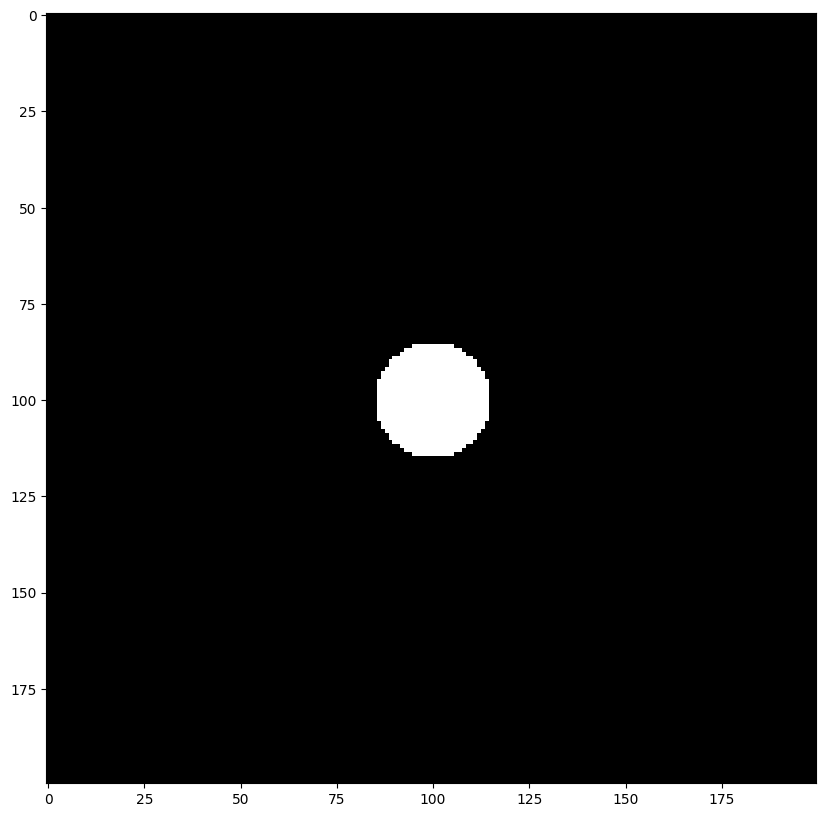

In [24]:
taille = 15 # opening size, in pixels
xx, yy = np.mgrid[:200, :200]

Sigma = (np.sqrt(((xx - xx.shape[0]//2) ** 2 + (yy - yy.shape[1]//2) ** 2))<taille).astype(float)

plt.figure()
plt.imshow(Sigma,cmap='gray')
plt.show()

> Display the amplitude of the spectrum of the opening using `np.fft.fft2` to compute 2D Fourier transform. Apply `np.fft.fftshift` to center it in [-1/2,1/2]*[-1/2,1/2]. What is the unit in term of frequencies (it was Hertz for a time defined signal for example)?

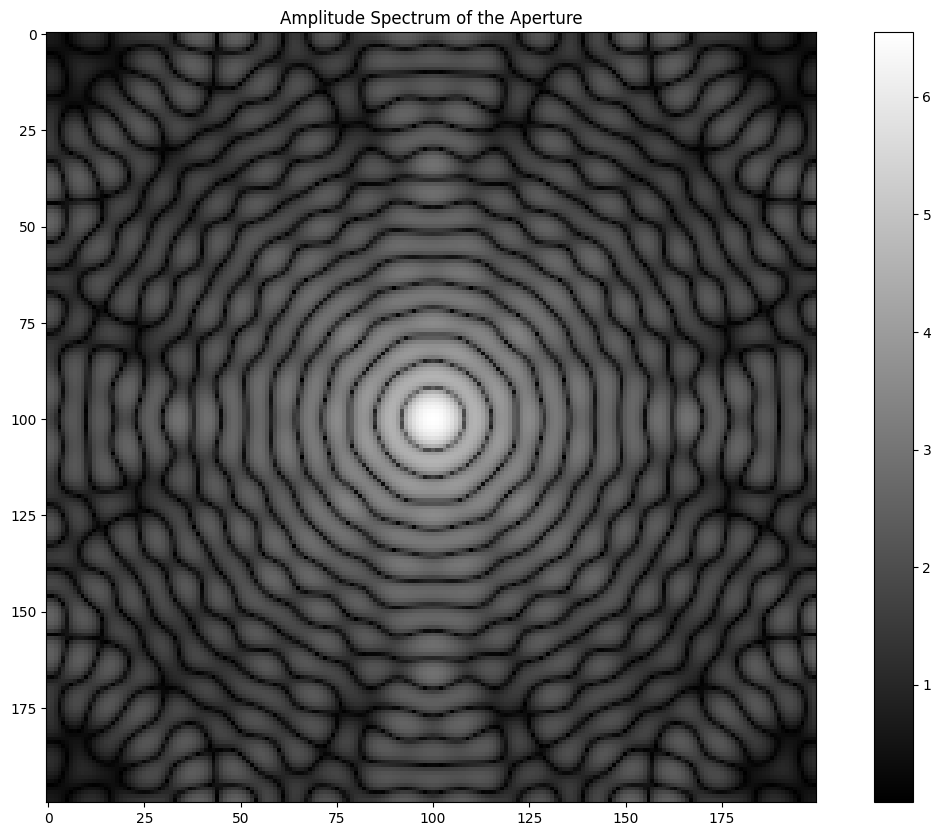

In [25]:
# Compute the 2D Fourier transform
fft2_Sigma = np.fft.fft2(Sigma)

# Shift the zero frequency to the center
shifted_fft2_Sigma = np.fft.fftshift(fft2_Sigma)

# Compute the amplitude spectrum
amplitude_spectrum = np.abs(shifted_fft2_Sigma)

# Display the amplitude spectrum
plt.figure()
plt.imshow(np.log1p(amplitude_spectrum), cmap='gray')  # Using log scale for better visibility
plt.title('Amplitude Spectrum of the Aperture')
plt.colorbar()
plt.show()

> This cell will create a night sky with $N$ stars with different intensity.

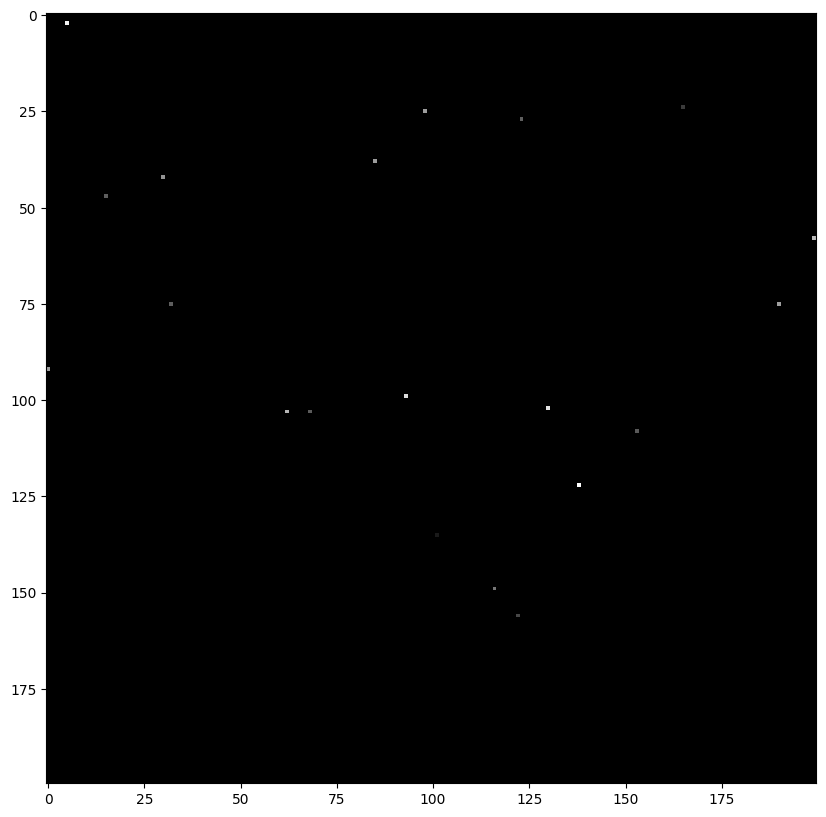

In [26]:
N = 20
size = 200
Sky = np.zeros((size**2))
idx = np.random.randint(0,Sky.shape[0],N)
Sky[idx] = np.random.rand(N)
Sky = Sky.reshape((size,size))
plt.figure()
plt.imshow(Sky,cmap='gray')
plt.show()

> Perform the convolution between the sky and the impulse response of the opening. Display the result.

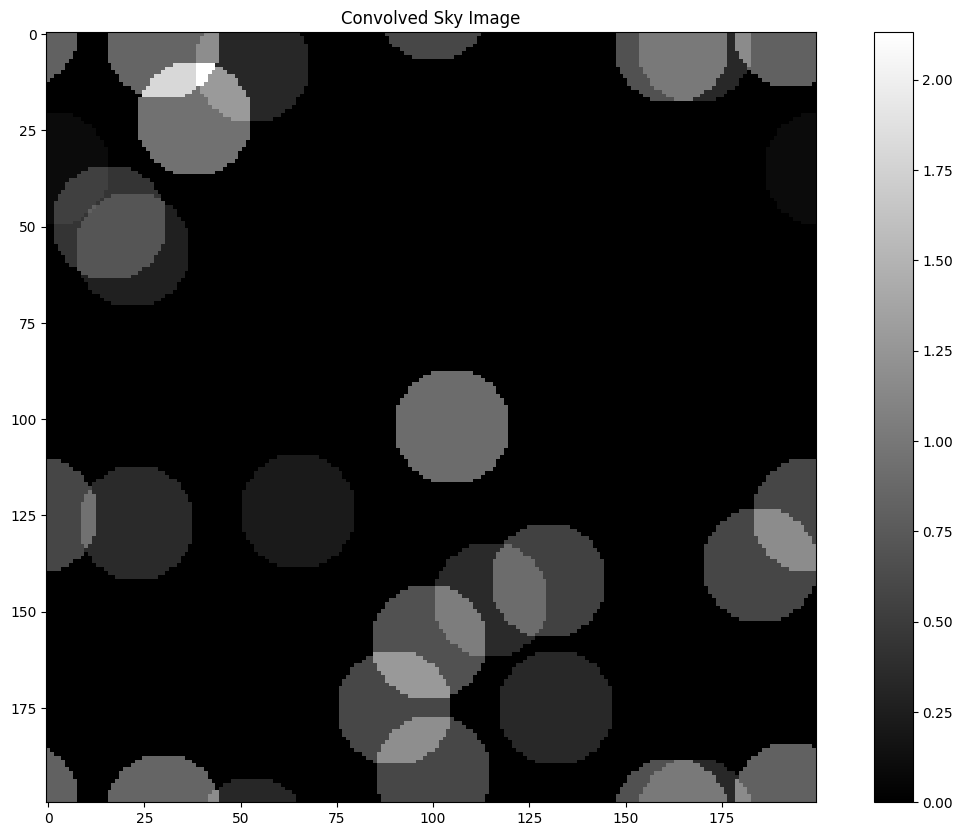

In [27]:
# Compute the 2D Fourier transforms
fft_sky = np.fft.fft2(Sky)
fft_sigma = np.fft.fft2(Sigma, s=Sky.shape)

# Multiply the two Fourier transforms (element-wise)
fft_convolved = fft_sky * fft_sigma

# Compute the inverse Fourier transform to get the convolved image
convolved_sky = np.fft.ifft2(fft_convolved)

# Display the result
plt.figure()
plt.imshow(np.abs(convolved_sky), cmap='gray')
plt.title('Convolved Sky Image')
plt.colorbar()
plt.show()

> Which effect does the aperture size has in the observed night sky?

Opening size : 0


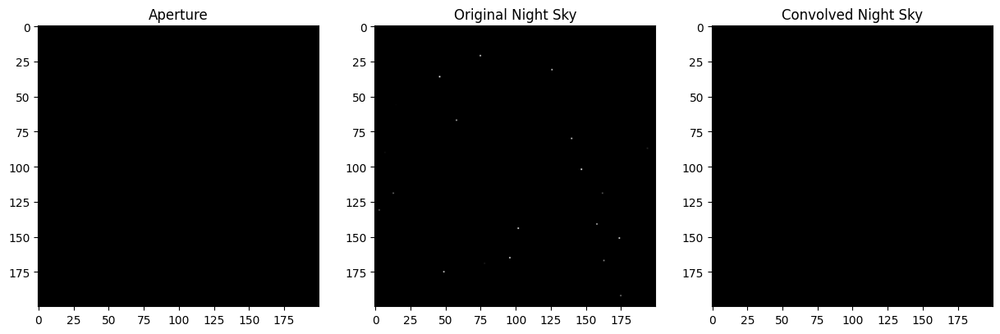

Opening size : 1


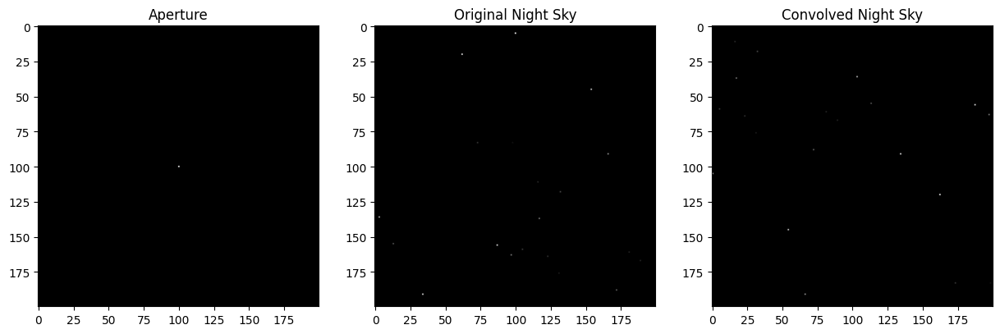

Opening size : 2


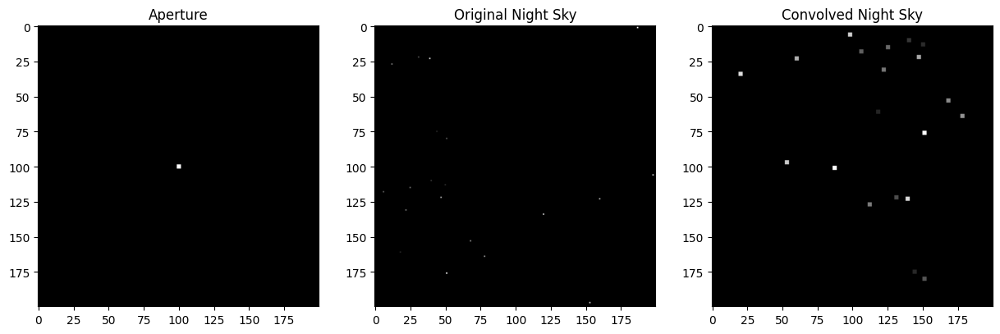

Opening size : 3


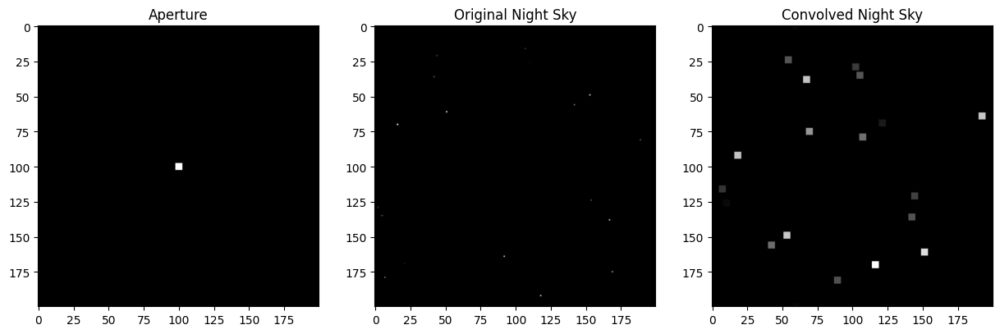

Opening size : 4


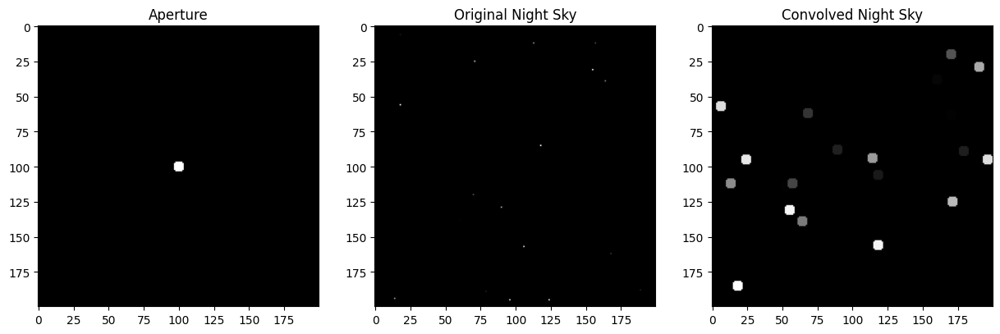

Opening size : 5


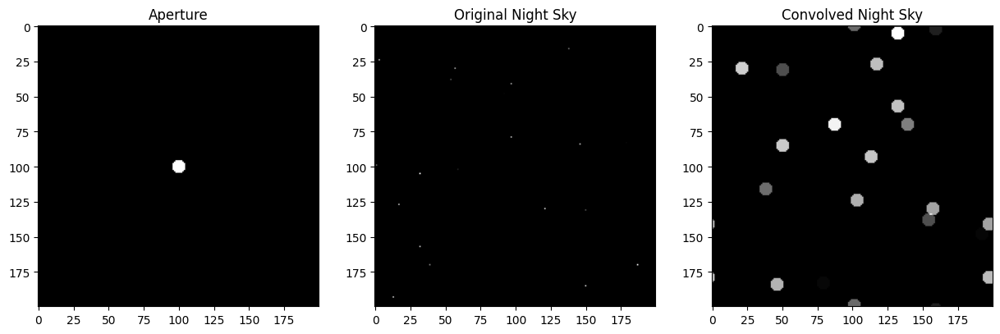

Opening size : 6


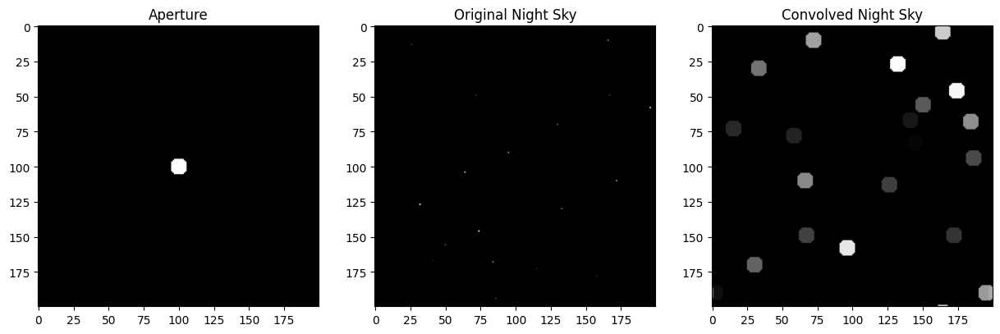

Opening size : 7


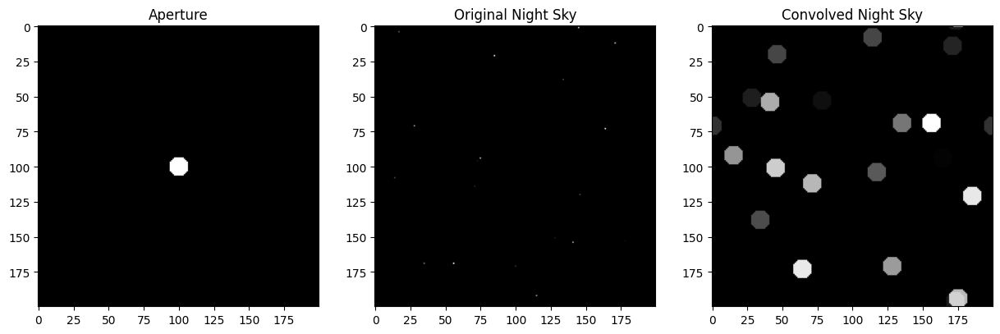

Opening size : 8


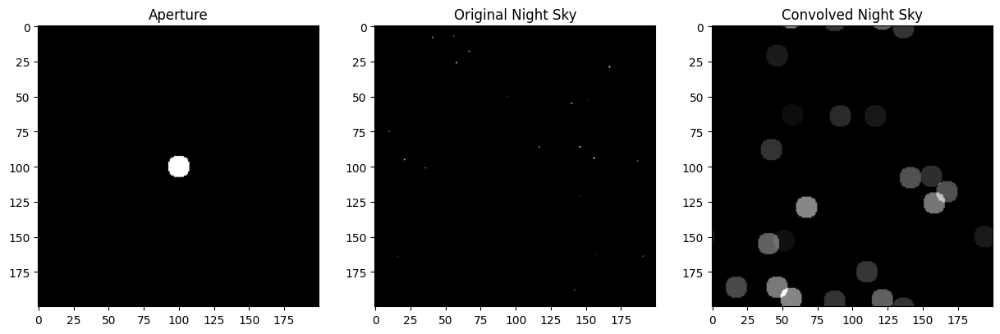

Opening size : 9


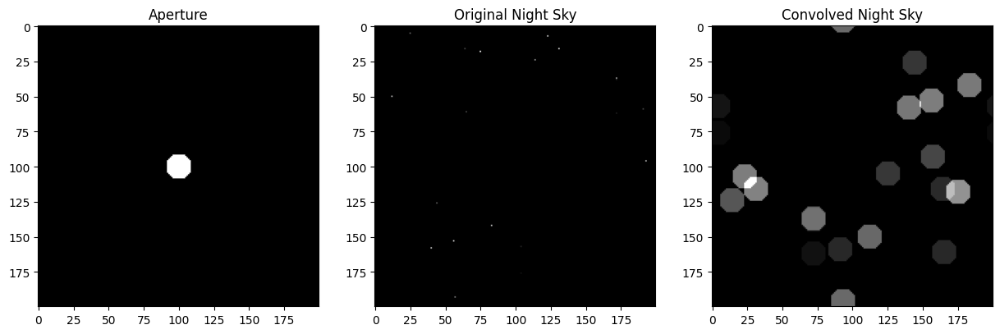

Opening size : 10


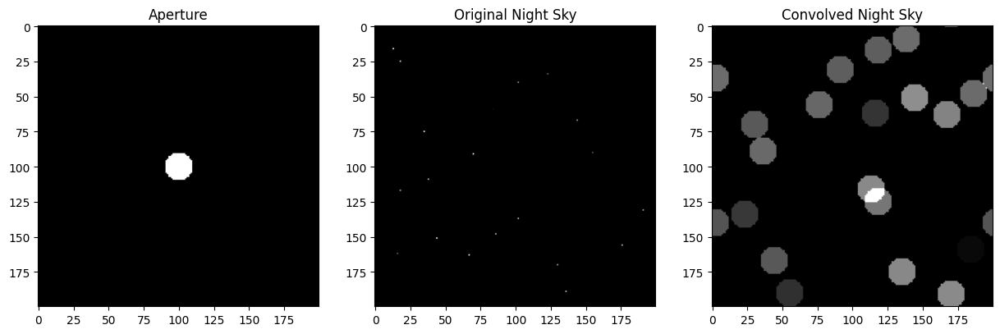

Opening size : 11


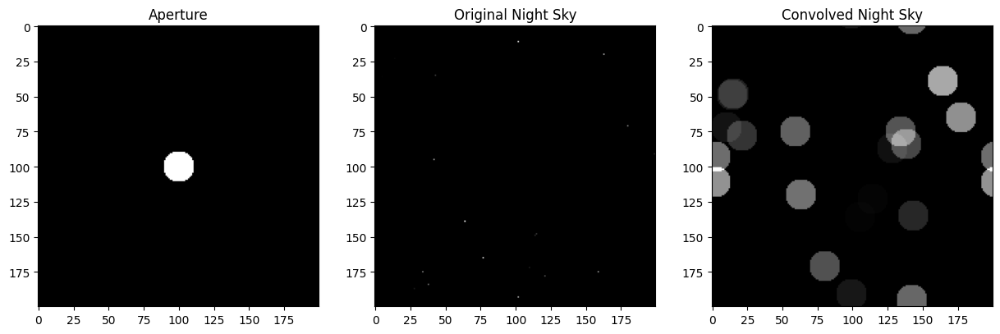

Opening size : 12


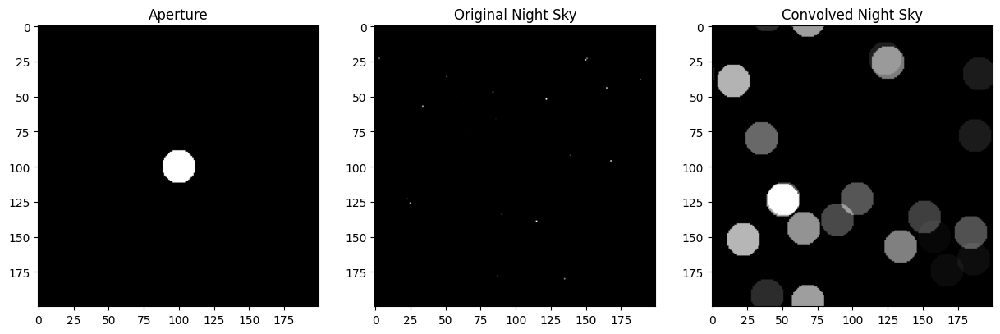

Opening size : 13


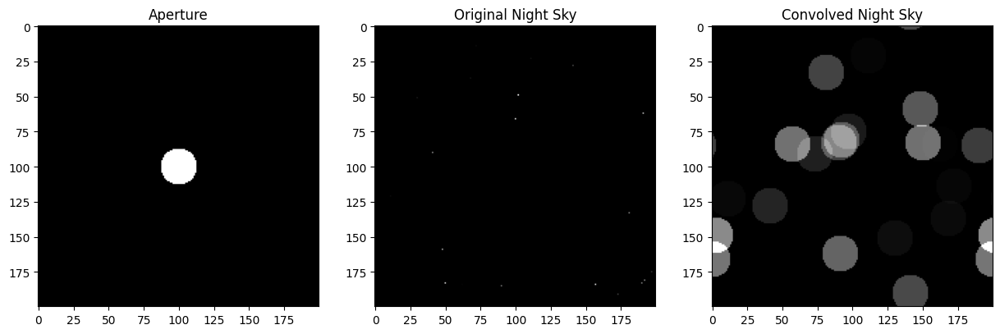

Opening size : 14


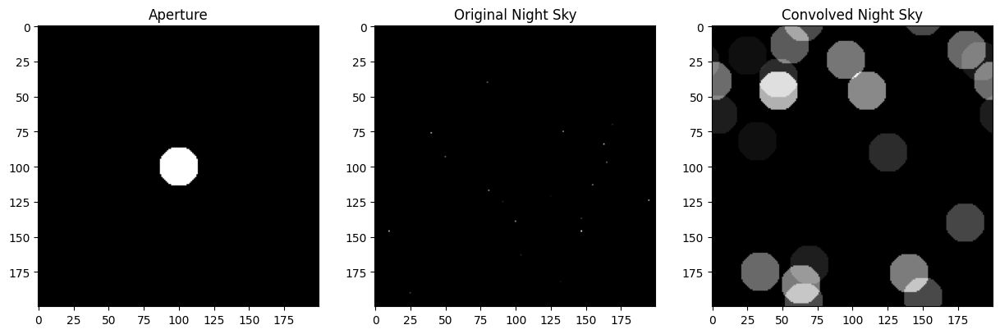

Opening size : 15


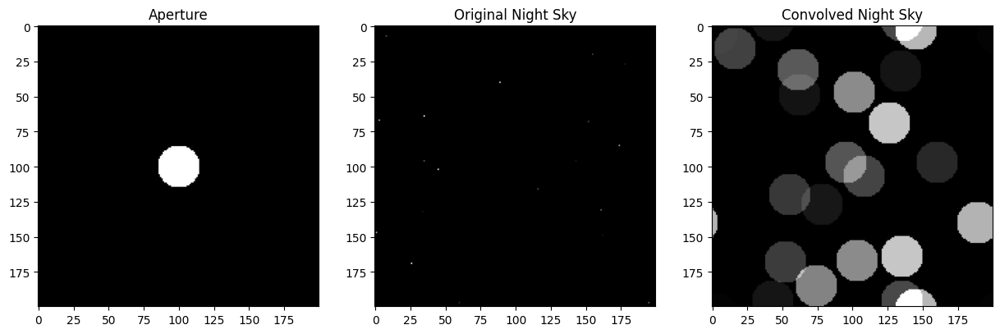

Opening size : 16


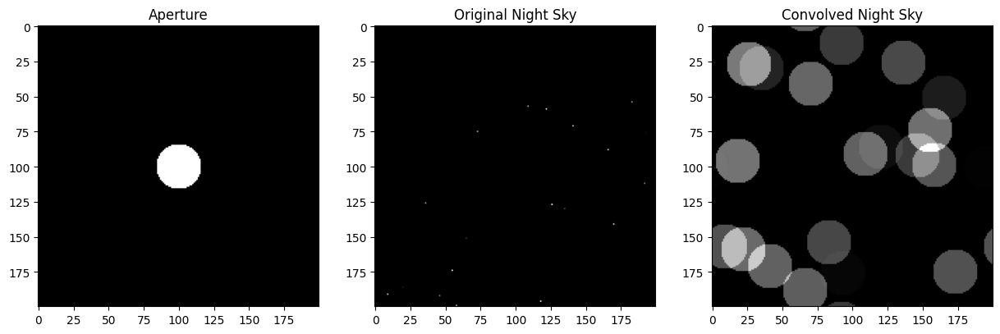

Opening size : 17


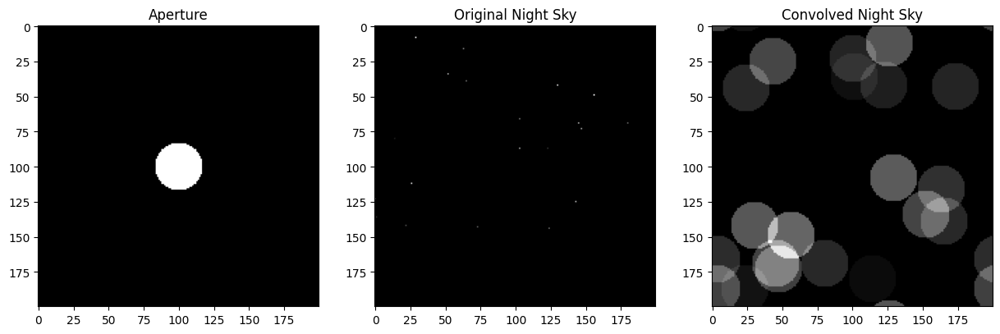

Opening size : 18


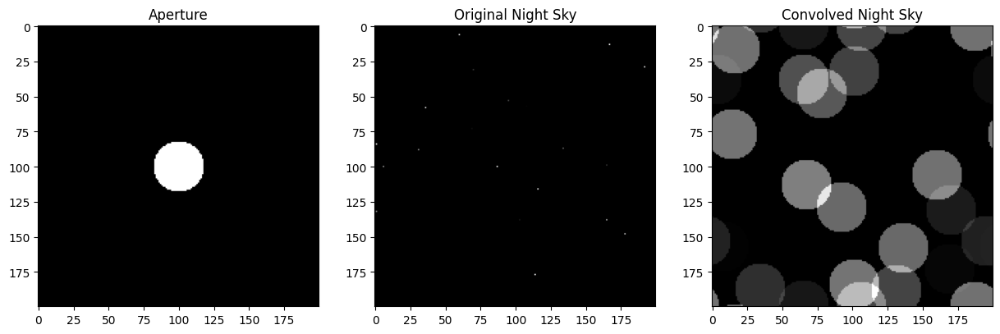

Opening size : 19


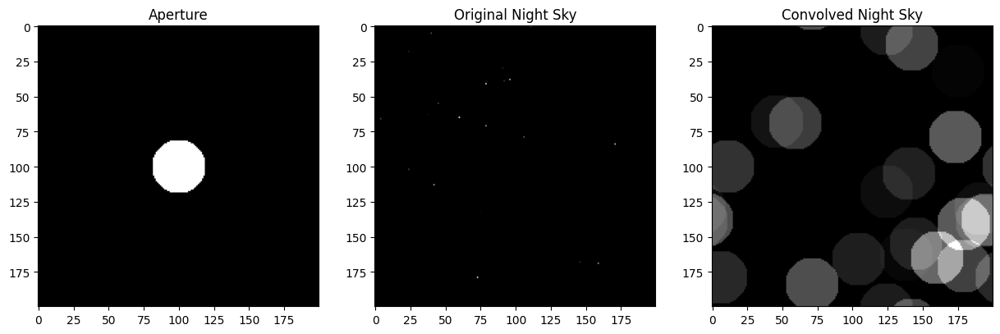

Opening size : 20


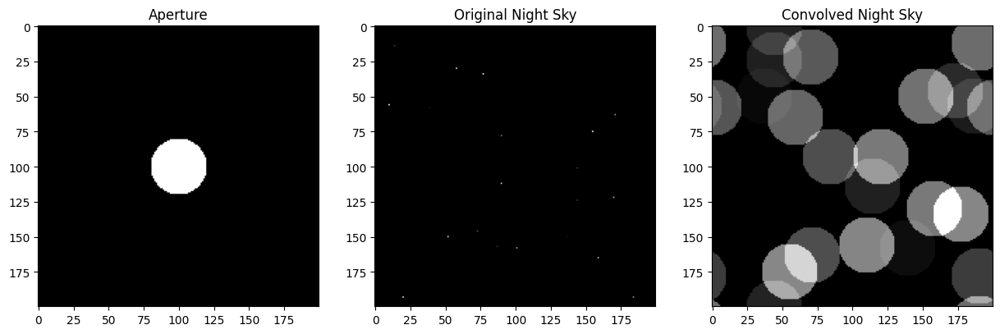

Opening size : 21


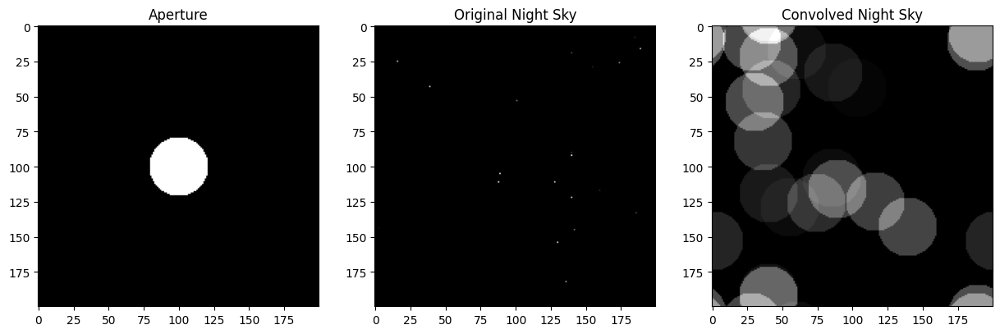

Opening size : 22


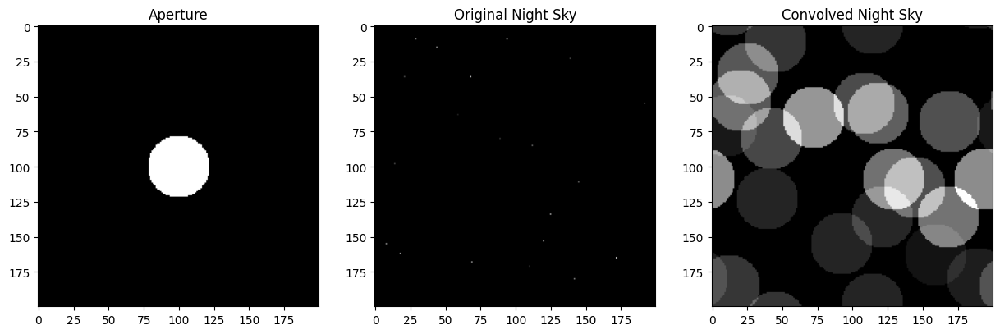

Opening size : 23


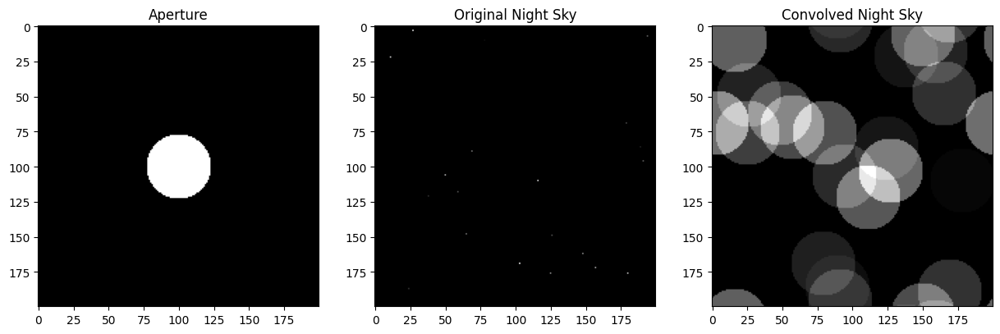

Opening size : 24


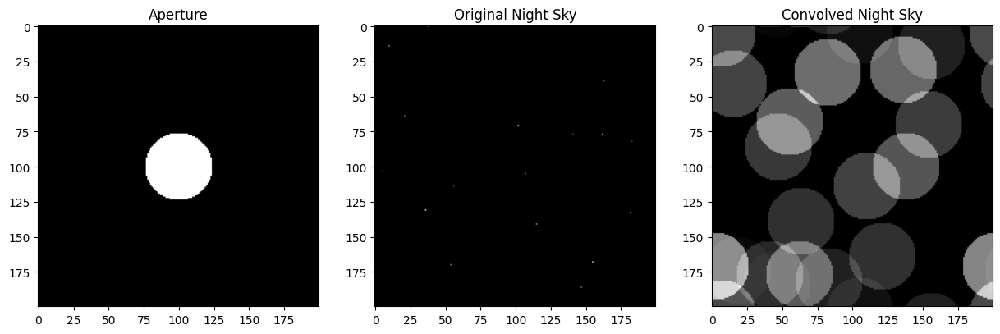

Opening size : 25


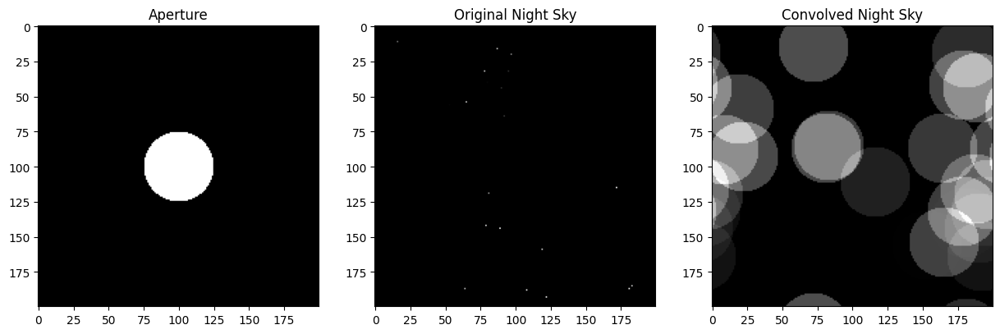

Opening size : 26


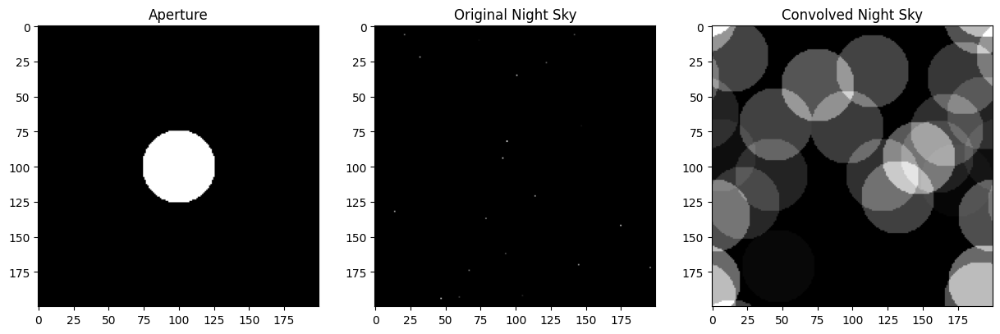

Opening size : 27


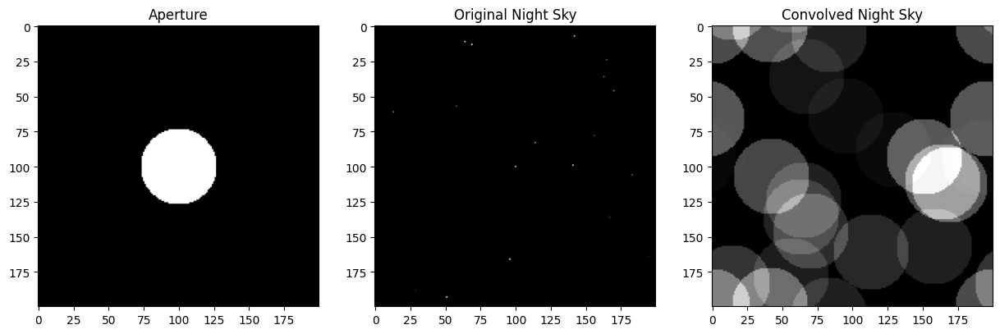

Opening size : 28


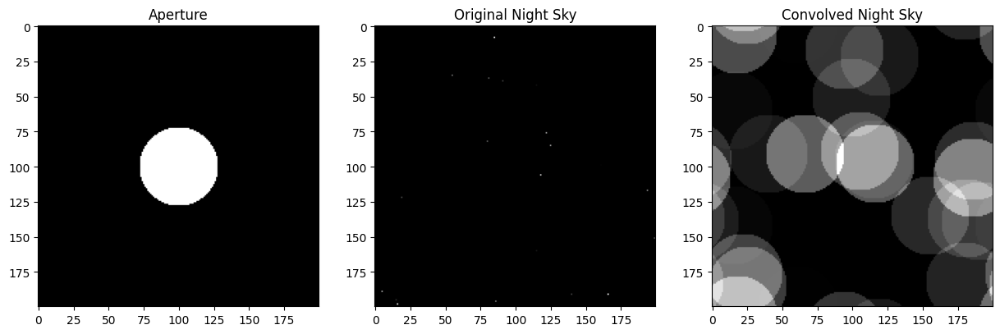

Opening size : 29


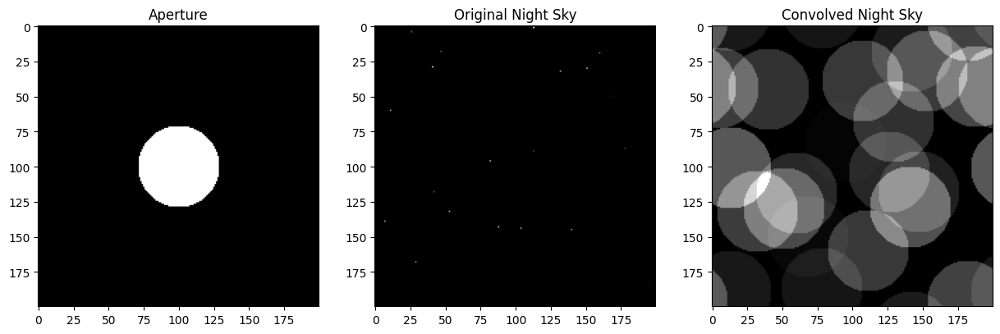

Opening size : 30


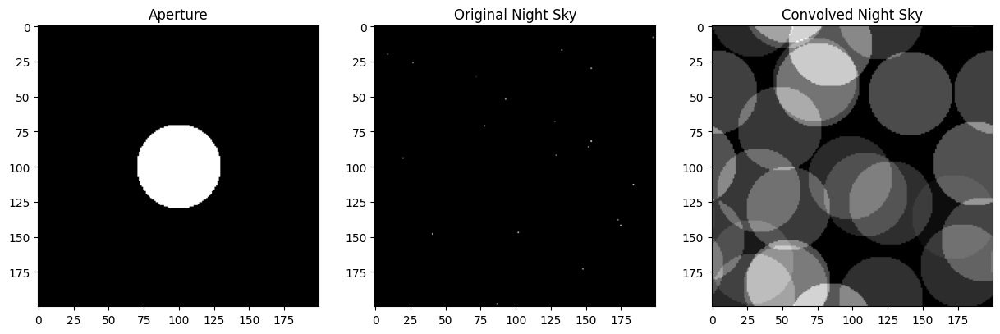

Opening size : 31


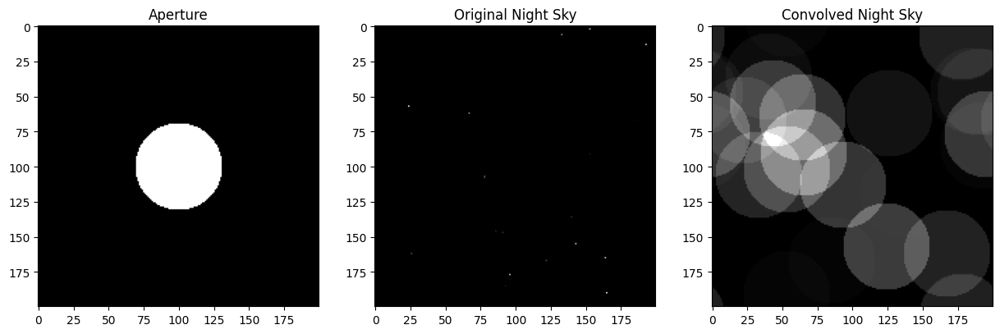

Opening size : 32


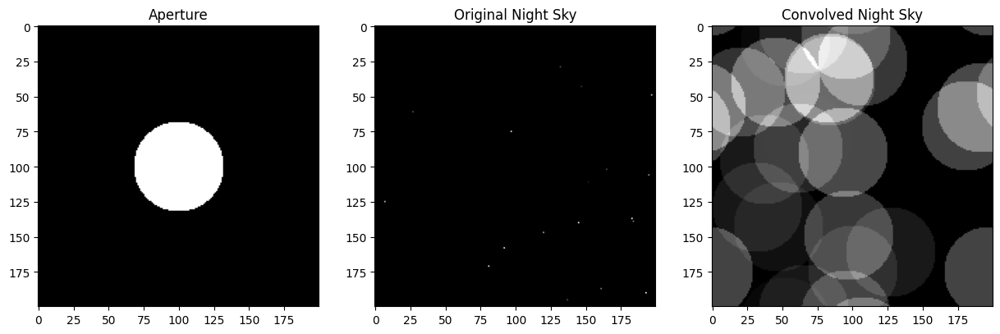

Opening size : 33


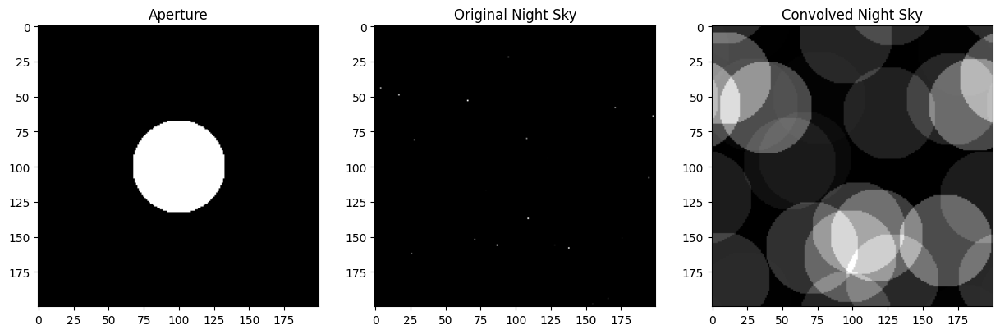

Opening size : 34


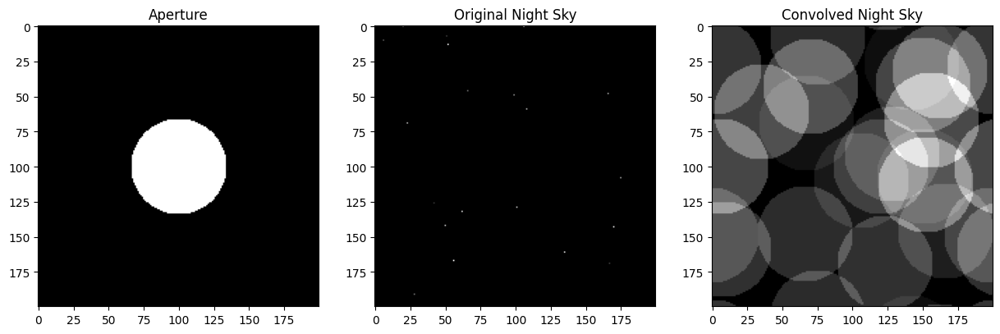

Opening size : 35


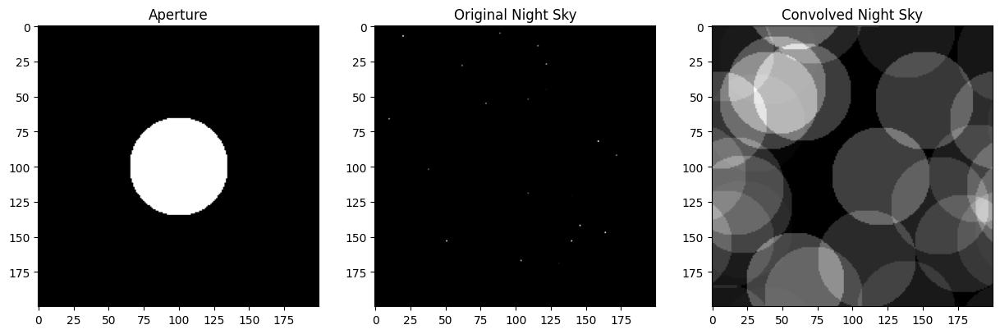

Opening size : 36


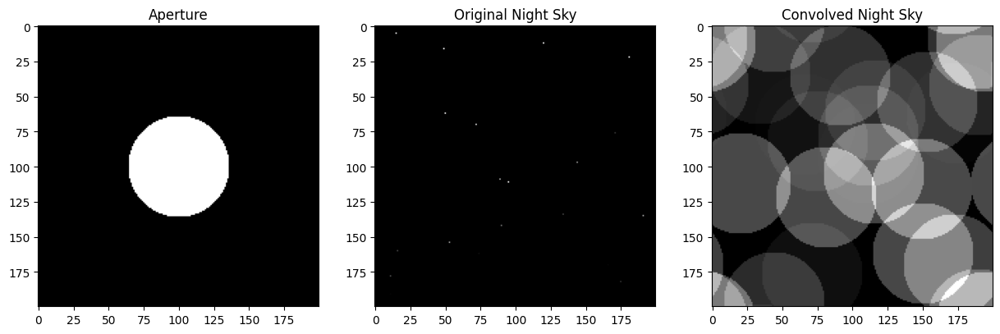

Opening size : 37


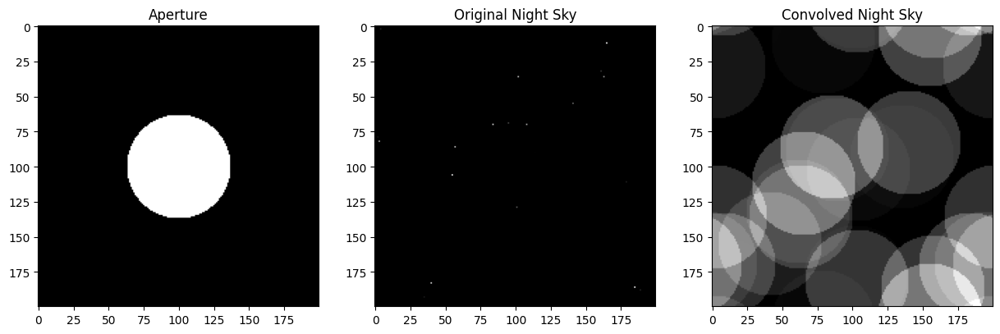

Opening size : 38


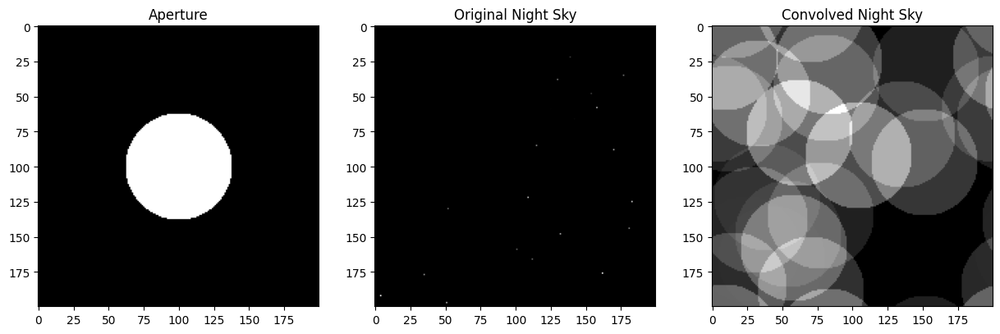

Opening size : 39


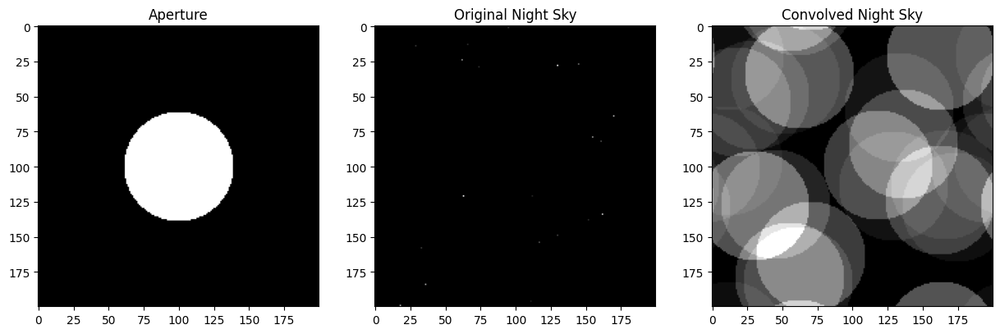

Opening size : 40


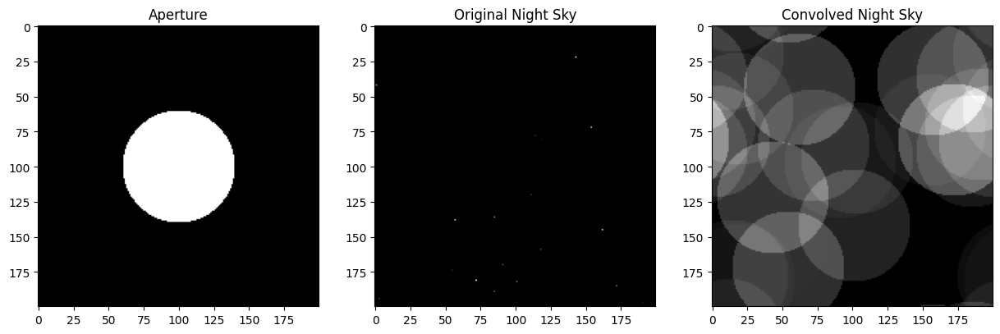

Opening size : 41


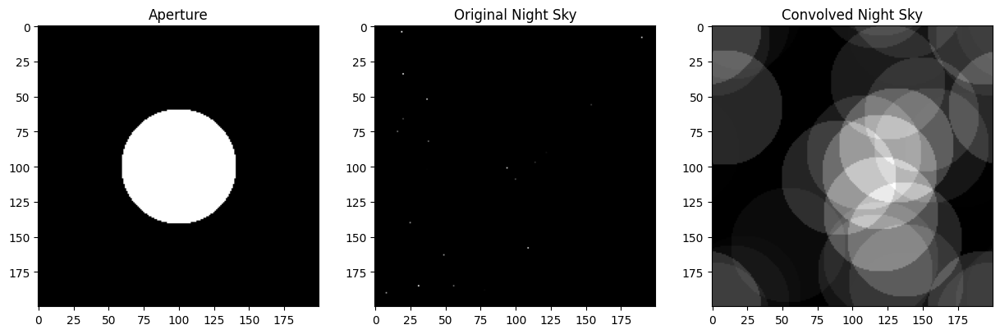

Opening size : 42


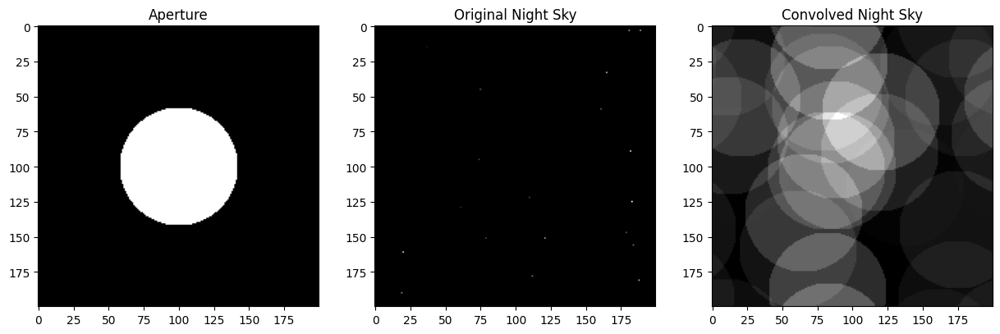

Opening size : 43


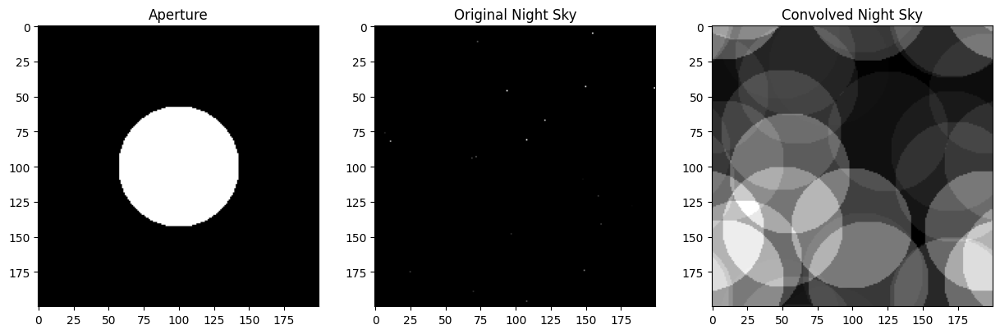

Opening size : 44


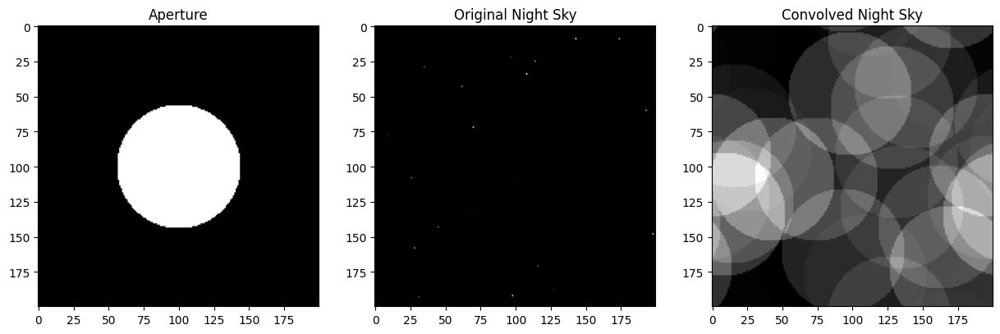

Opening size : 45


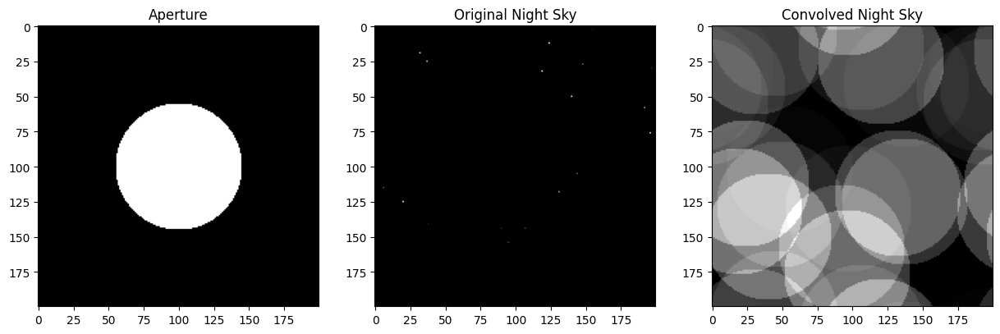

Opening size : 46


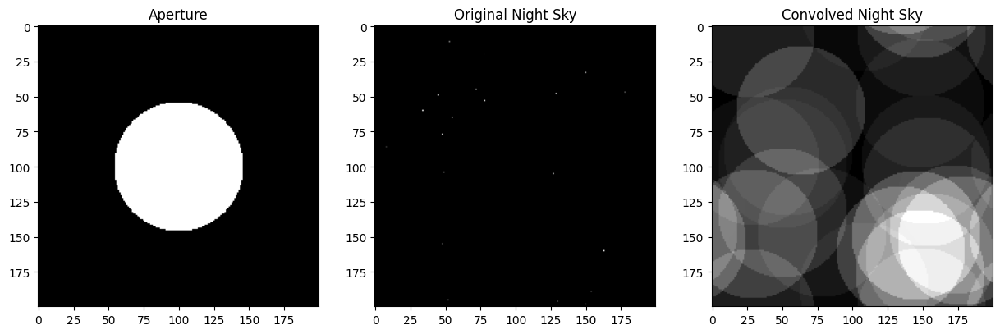

Opening size : 47


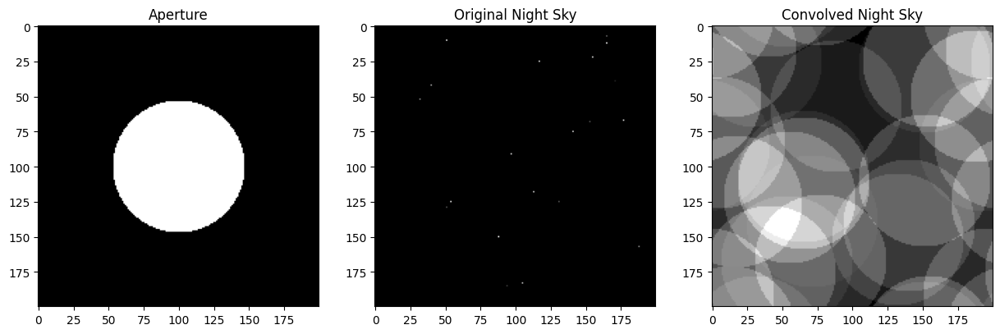

Opening size : 48


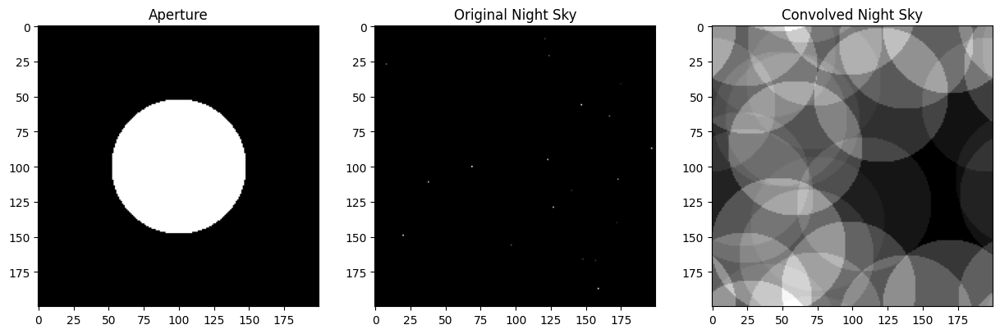

Opening size : 49


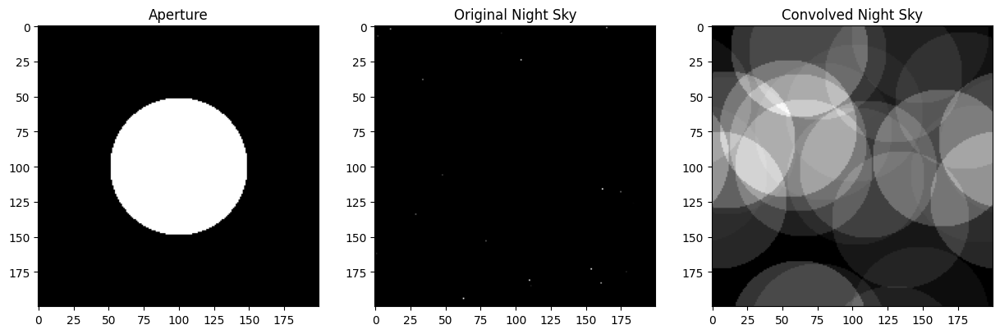

Opening size : 50


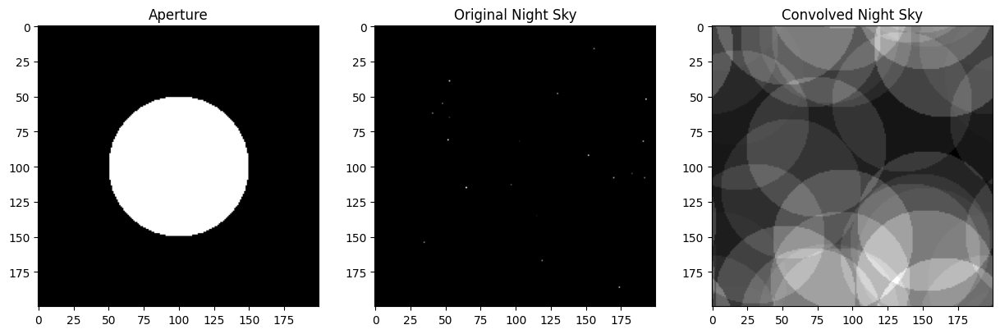

In [28]:
# Defining the aperture
#taille = 30  # opening size, in pixels
for taille in range(51):
  xx, yy = np.mgrid[:200, :200]
  Sigma = (np.sqrt(((xx - xx.shape[0]//2) ** 2 + (yy - yy.shape[1]//2) ** 2)) < taille).astype(float)

  # Creating a night sky with N stars
  N = 20
  size = 200
  Sky = np.zeros((size**2))
  idx = np.random.randint(0, Sky.shape[0], N)
  Sky[idx] = np.random.rand(N)
  Sky = Sky.reshape((size, size))

  # Compute the 2D Fourier transforms
  fft_sky = np.fft.fft2(Sky)
  fft_sigma = np.fft.fft2(Sigma, s=Sky.shape)

  # Multiply the two Fourier transforms (element-wise)
  fft_convolved = fft_sky * fft_sigma

  # Compute the inverse Fourier transform to get the convolved image
  convolved_sky = np.fft.ifft2(fft_convolved)

  # Setting up the plots
  fig, axes = plt.subplots(1, 3, figsize=(15, 5))

  # Original aperture
  axes[0].imshow(Sigma, cmap='gray')
  axes[0].set_title('Aperture')

  # Original sky
  axes[1].imshow(Sky, cmap='gray')
  axes[1].set_title('Original Night Sky')

  # Convolved sky
  axes[2].imshow(np.abs(convolved_sky), cmap='gray')
  axes[2].set_title('Convolved Night Sky')
  print(f"Opening size : {taille}")
  plt.show()


With small aperture sizes, the stars appear more blurred in the convolved night sky images. This is because smaller apertures cause more significant diffraction, spreading out the light and leading to less sharp images.

As the aperture size increases, the stars become sharper and more distinct in the convolved images. Larger apertures reduce the effects of diffraction and allow more details to be captured, making the stars appear clearer and more defined.

 The size of the telescope's opening is important. Larger apertures give us clearer and more detailed views of the stars, while smaller apertures can make the images blurrier and less detailed.

In [29]:
import markdown